<a href="https://colab.research.google.com/github/drag0o0n/FDMA-signals/blob/main/FilterAudioSignal_LPF_SpecificBandwidth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>




Communication Project

Python code will read the input as a (.wav) file which is a type of audio files taking from it the samplig rate and the data as an array.
the program will plot the time and frequency plots for the signal read from the audio file.
the user is asked to enter the suitable filter bandwidth to cut the frequnecy above (-Bw) and (BW) then the signal after the filteration will be plotted in time and frequency domains

22050
[-3157 -2169   194 ... -2137  5447  9069]


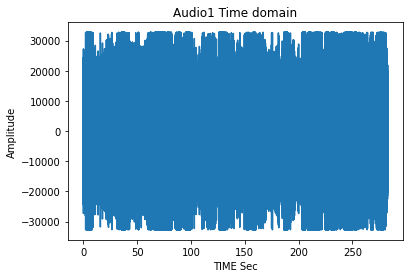

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:82: DeprecationWarning: Using scipy.fft as a function is deprecated and will be removed in SciPy 1.5.0, use scipy.fft.fft instead.


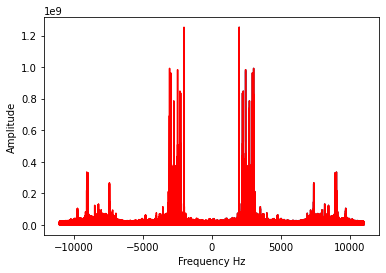

please enter the bandwidth for the LPF1000


/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1317: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


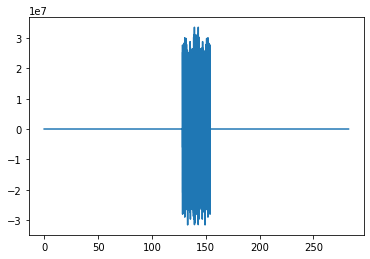

In [ ]:
#importing all necessary libraries to use functions from them
import matplotlib.pyplot as PLot
import numpy as np
import random
import scipy
import wave
import struct
import pylab
import pdb
from scipy.io import wavfile

import scipy.fftpack as fftpk
#the file contains the wave name
WaveFile = '/content/FDMAMixedAudio1.wav'
filenameWavefiltered='./Filtered.wav'


#read the data from the file and take and return the sample rate in Samples/sec and data from
#the .wav file in array
sampleRate, data = wavfile.read(WaveFile)
if len(data.shape) > 1:
   data=data[:,0]
filtereddata = np.fft.rfft(data, axis=0)

filteredwrite = np.fft.irfft(filtereddata, axis=0)
print(sampleRate)#print out the sample rate for the wave read
#print the array contains the numeric data for the signal
print(data)

#calculating the duration
duration = len(data)/sampleRate
#setting time vector
D =len(data)*(1.0/sampleRate)
#arrange function takes 
#start point set as 0 
#stop value set as D
#step size which is the sampling interval 
TSSS=1.0/sampleRate
time= np.arange(0,len(data)*TSSS,TSSS) 

y = [float(x) for x in data]

read=1
write=1


if write!=0:

  fileHandl = open("Text.txt", "w")#write on text file
  for i in range(len(y)):
    fileHandl.write(str(y[i])+ " " + str(float(time[i]))+"\n")
  fileHandl.close()

if read !=0:
  with open("Text.txt") as FFILE:
    w=FFILE.read()
  y=[];
  t=[];
  for x in w.split('\n'): #splitting lines 
    if x != '':
      y.append(float(x.split()[0]))
      t.append(float(x.split()[1]))









#this used for plotting the results we got for the signal
#in both time and frequency domain
PLot.plot(time,data)
PLot.xlabel('TIME Sec')
PLot.ylabel('Amplitude')
PLot.title('Audio1 Time domain')
PLot.show()
#next function will compute the discrete fourier transform(DFT)
#by using a method called Fast Fourier Transform

FFT = abs(scipy.fft(data))
freqs = fftpk.fftfreq(len(FFT), (1/sampleRate) )

PLot.plot(freqs[range(len(FFT)//2)], FFT[range(len(FFT)//2)])
PLot.xlabel('Frequency Hz')
PLot.ylabel('Amplitude')
      # reading the info from the wavefile (.wav)
#*****************************************
BWrange=20000 #plot bandwidth range
DataLength = len(data)
K = np.arange(DataLength)
frq = K/duration #2side frequency
fcen=frq[int(len(frq)/2)]


frq_DoubleSide = frq-fcen




frq_SingleSide = frq[range(int(DataLength/2))]
Y=np.fft.fft(data)
yinv=np.fft.ifft(Y).real


#roll data for plotting the 2 sides for signal
Y_DoubleSide=np.roll(Y,int(DataLength/2))
Y_SingleSide = Y[range(int(DataLength/2))]
fcenindex=(np.abs(frq_DoubleSide)).argmin()
Rangeindex=(np.abs(frq_DoubleSide-BWrange)).argmin()-fcenindex
rangeindexmin = fcenindex-Rangeindex

if rangeindexmin <0:
  rangeindexmin =0

rangeindexmax = fcenindex+Rangeindex
if rangeindexmax > len(frq_DoubleSide)-1:
  rangeindexmax =len(frq_DoubleSide)-1





PLot.plot(frq_DoubleSide[rangeindexmin: rangeindexmax], abs (Y_DoubleSide [rangeindexmin:rangeindexmax]),'r')
PLot.show()



#generation of new signal


SignalLength = len(y)
KK = np.arange(SignalLength)
TT = SignalLength/ sampleRate
frequency = KK/TT
fcen1 = frequency[int(len(frequency)/2)]
frequency_Doubleside = frequency - fcen1
frequence_Singleside = frequency[range(int(SignalLength/2))]

BW = input("please enter the bandwidth for the LPF")
#LPF : Low Pass Filter
BW = int(BW)


fBWIndex = (np.abs(frq_DoubleSide - BW)).argmin()
BW = frq_DoubleSide[fBWIndex]



Mask_DS=np.ones(len(frq_DoubleSide))
Yf_DS=np.copy(Y_DoubleSide)
Bmax=frq_DoubleSide[len(frq_DoubleSide)-1]
Bmin=0
Bold=0



Yf_DS=np.copy(Y_DoubleSide)
for cnt in range(len(frq_DoubleSide)):
  if ~(((frq_DoubleSide[cnt])>-1*BW) and ((frq_DoubleSide[cnt])<BW)):
    Mask_DS[cnt]=0;
    Yf_DS[cnt]=Y_DoubleSide[cnt]*0;




Yf=np.roll(Yf_DS,int(SignalLength/2))
yinv= np.fft.ifft(Yf).real # ifft computing and normalization
yinv=np.array(yinv)
yinv_int=yinv.astype(np.int16)
PLot.plot(time,Yf_DS)

wavfile.write(filenameWavefiltered, sampleRate, yinv_int)



Play the Original Audio Signal

In [5]:
from IPython.display import Audio
# Generate a player for mono sound
Audio(data,rate=sampleRate)

Play the filtered Audio Signal

Filtered

In [6]:
from IPython.display import Audio
# Generate a player for mono sound
Audio(yinv,rate=sampleRate)